In [1]:
!pip install --upgrade git+https://github.com/kornia/kornia.git

  Cloning https://github.com/kornia/kornia.git to /private/var/folders/74/9jmpb1lx77dbqqtjdwrlwtzc0000gn/T/pip-req-build-odhsxksg
  Running command git clone -q https://github.com/kornia/kornia.git /private/var/folders/74/9jmpb1lx77dbqqtjdwrlwtzc0000gn/T/pip-req-build-odhsxksg
  Created wheel for kornia: filename=kornia-0.3.2+f4f70fe-py2.py3-none-any.whl size=179890 sha256=9e7c4528f0d64868921b85401c2add6e8bd6ca3352e79f8fd06b8c160308769c
  Stored in directory: /private/var/folders/74/9jmpb1lx77dbqqtjdwrlwtzc0000gn/T/pip-ephem-wheel-cache-adactx4k/wheels/88/b9/76/53a61ea227ede8a4edafc4c05de647b48764b8fccde51cd50c
Successfully built kornia
  Attempting uninstall: kornia
    Found existing installation: kornia 0.3.2+f4f70fe
    Uninstalling kornia-0.3.2+f4f70fe:
      Successfully uninstalled kornia-0.3.2+f4f70fe


### Import needed libs and sample image

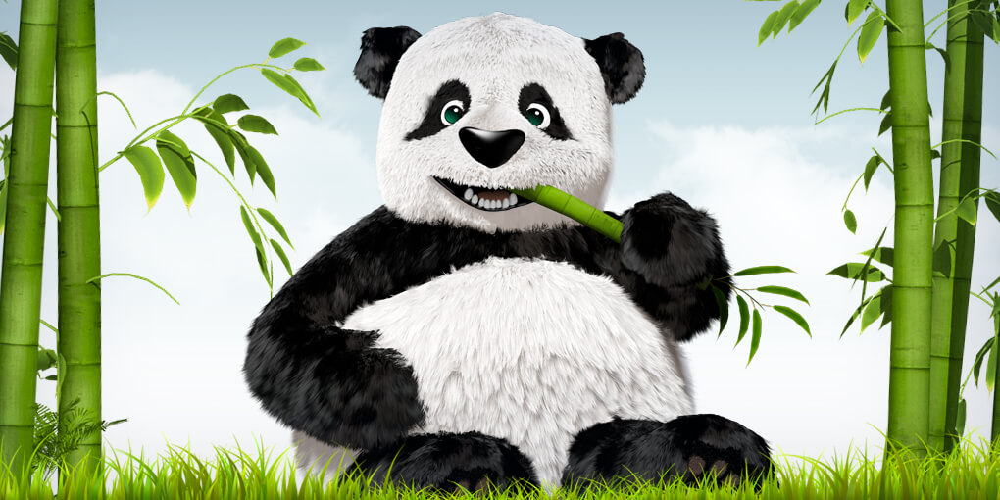

In [2]:
from PIL import Image
import requests
from io import BytesIO
import torch
from torch import allclose
from torch.testing import assert_allclose

import kornia
from kornia.constants import Resample
from kornia.color import *
from kornia import augmentation as K
import kornia.augmentation.functional as F
import kornia.augmentation.random_generator as rg
from torchvision.transforms import functional as tvF
from torchvision.transforms import transforms

import matplotlib.pyplot as plt
import numpy as np

to_tensor = transforms.ToTensor()
to_pil = transforms.ToPILImage()

def tensor_pre_transform_wrapper(input: torch.Tensor):
    """ A wrapper that tried to reproduce the actual output from:
        - transforms.ToPILImage()
        - transforms.ToTensor()
        For each image, simply (img * 255).int() // 255
    """
    return torch.round(input * 255).to(torch.uint8) / 255.

response = requests.get("https://tinypng.com/images/social/website.jpg")
img = Image.open(BytesIO(response.content))
img

### Transformations against Torchvision

#### HFlip

In [3]:
in_tensor = to_tensor(img)
in_pil = img
out_tensor = F.apply_hflip(tensor_pre_transform_wrapper(in_tensor), {'batch_prob': torch.tensor(True)})
out_pil = tvF.hflip(in_pil)

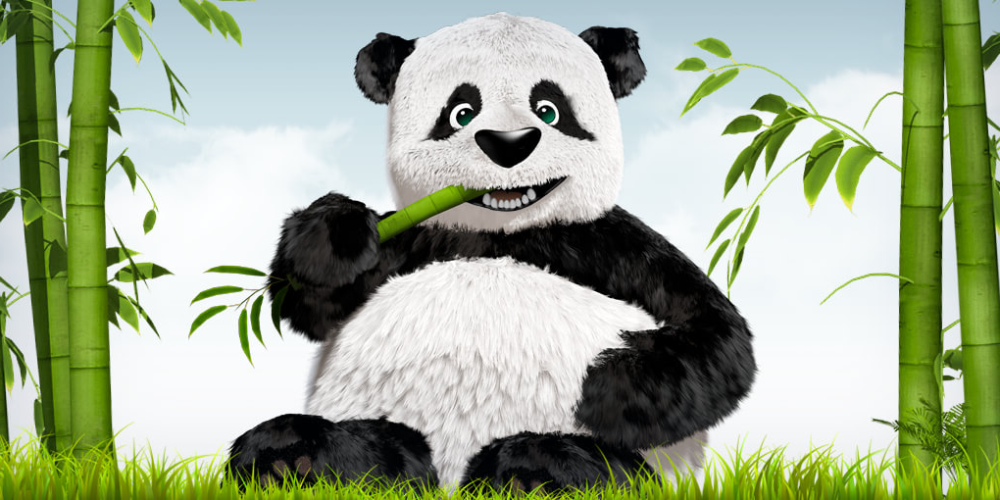

In [4]:
out_pil

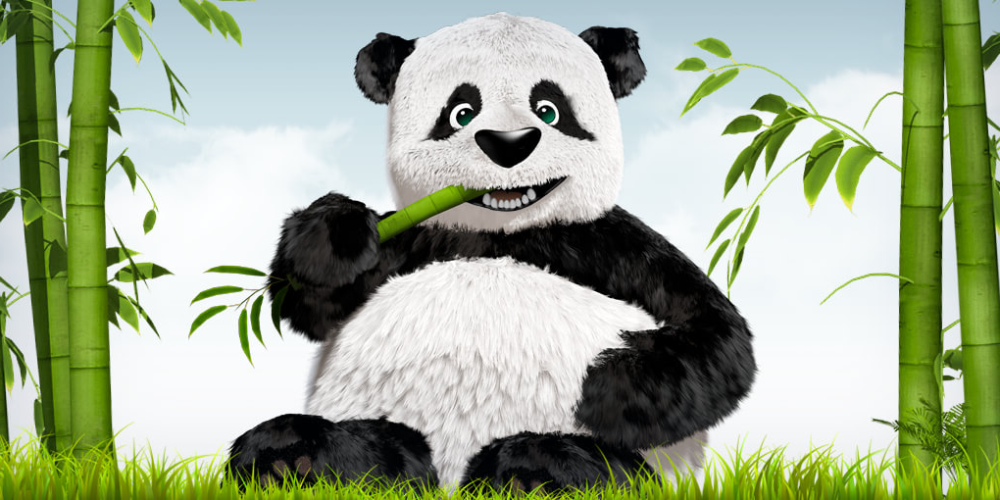

In [5]:
to_pil(out_tensor.squeeze())

#### VFlip

In [6]:
in_tensor = to_tensor(img)
in_pil = img
out_tensor = F.apply_vflip(tensor_pre_transform_wrapper(in_tensor), {'batch_prob': torch.tensor(True)})
out_pil = tvF.vflip(in_pil)

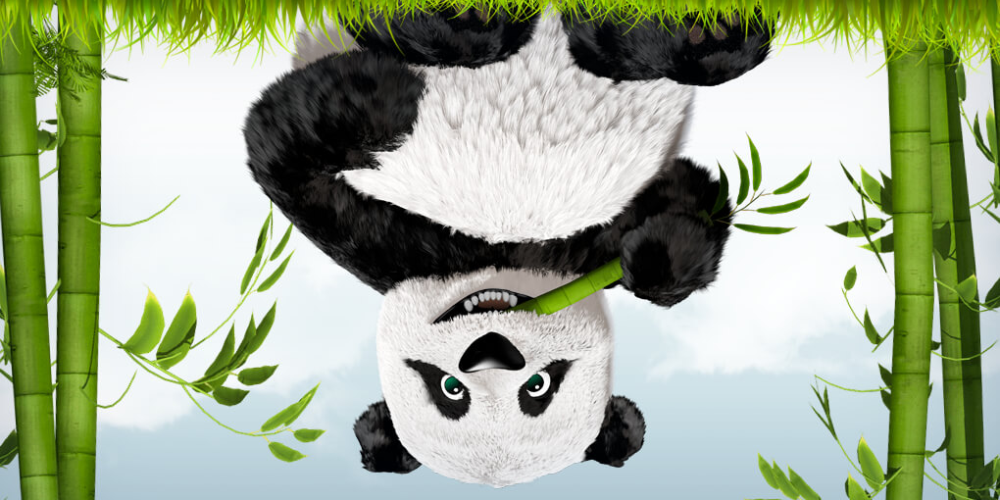

In [7]:
out_pil

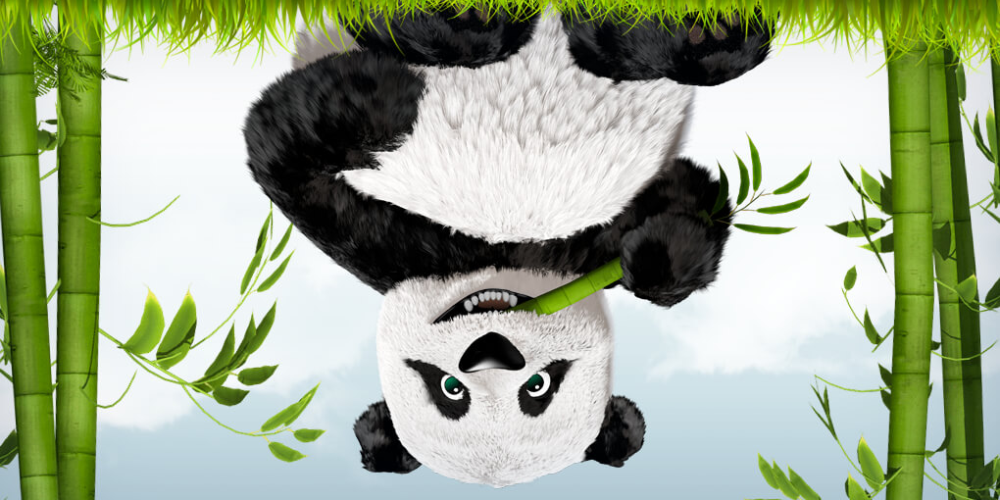

In [8]:
to_pil(out_tensor.squeeze())

#### Rotation

Images rotated by Kornia is smoother than Torchvision.

In [9]:
in_tensor = to_tensor(img)
in_pil = img
degrees = 10
out_tensor = F.apply_rotation(
    tensor_pre_transform_wrapper(in_tensor), {'degrees': torch.tensor(degrees), 'interpolation': torch.tensor([1]), 'align_corners': torch.tensor(True)})
out_pil = tvF.rotate(in_pil, resample=Image.BILINEAR, angle=degrees)

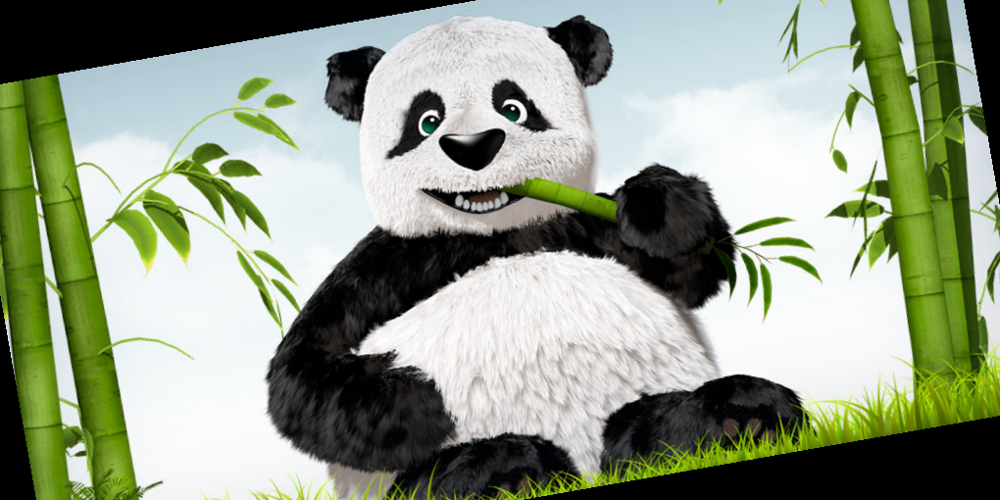

In [10]:
out_pil

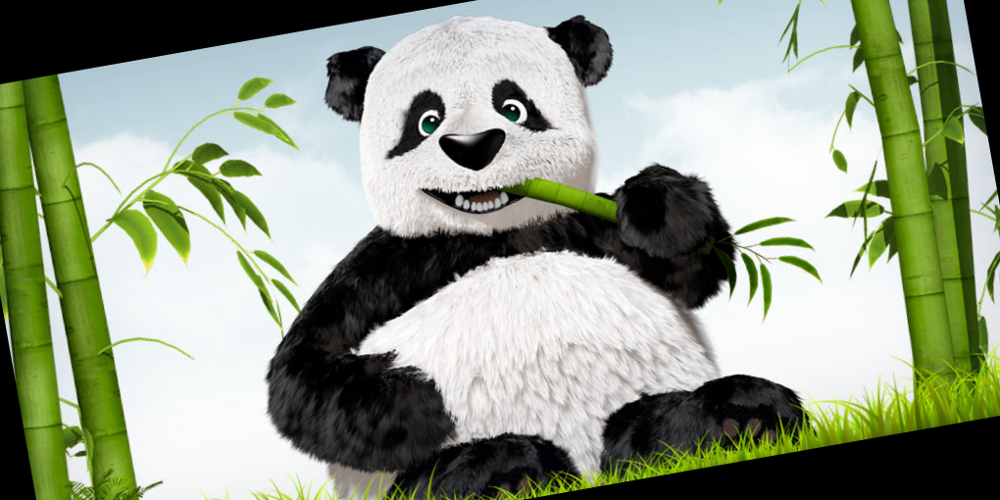

In [11]:
to_pil(out_tensor.squeeze())

#### Center Crop

In [12]:
in_tensor = to_tensor(img)
in_pil = img
cc = K.CenterCrop((300, 300), False)
out_tensor = cc(tensor_pre_transform_wrapper(in_tensor.unsqueeze(dim=0)))
out_pil = tvF.center_crop(in_pil, (300, 300))

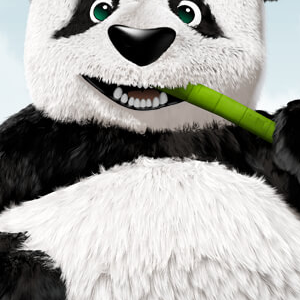

In [13]:
out_pil

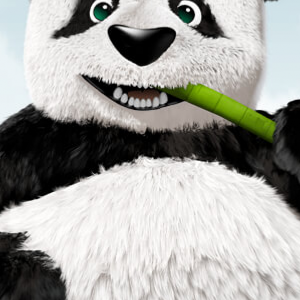

In [14]:
to_pil(out_tensor.squeeze())

#### Erase

In [15]:
in_tensor = to_tensor(img)
in_pil = img
rect_params = rg.random_rectangles_params_generator(
    1, in_tensor.size(1), in_tensor.size(2), 1.0, (0.1, 1.0), (0.1, 0.1)
)
out_tensor = F.apply_erase_rectangles(
    tensor_pre_transform_wrapper(in_tensor.unsqueeze(dim=0)), rect_params)
out_pil = tvF.erase(tensor_pre_transform_wrapper(
    in_tensor.unsqueeze(dim=0)).squeeze(), rect_params["ys"].item(), rect_params["xs"].item(), rect_params["heights"].item(), rect_params["widths"].item(), 0)

In [16]:
rect_params

{'widths': tensor([1020], dtype=torch.int32),
 'heights': tensor([218], dtype=torch.int32),
 'xs': tensor([0], dtype=torch.int32),
 'ys': tensor([282], dtype=torch.int32),
 'values': tensor([0.])}

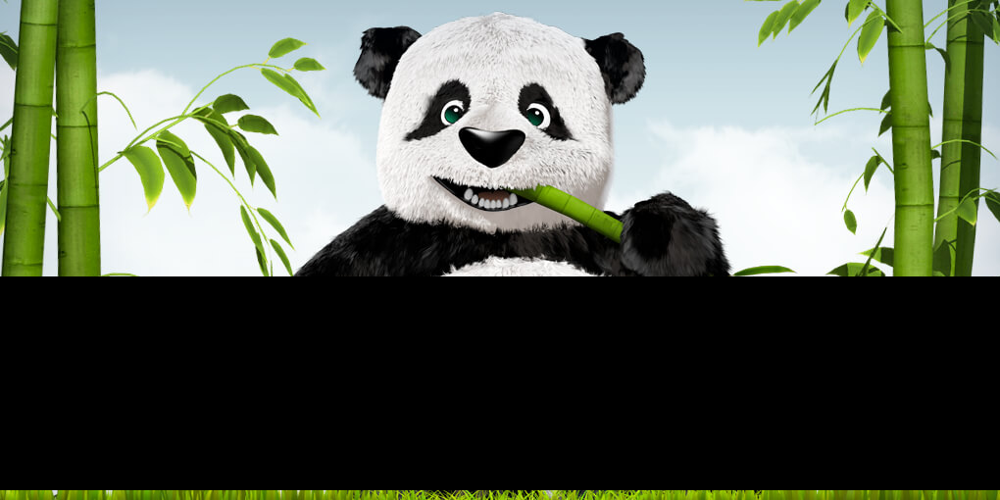

In [17]:
to_pil(out_tensor.squeeze())

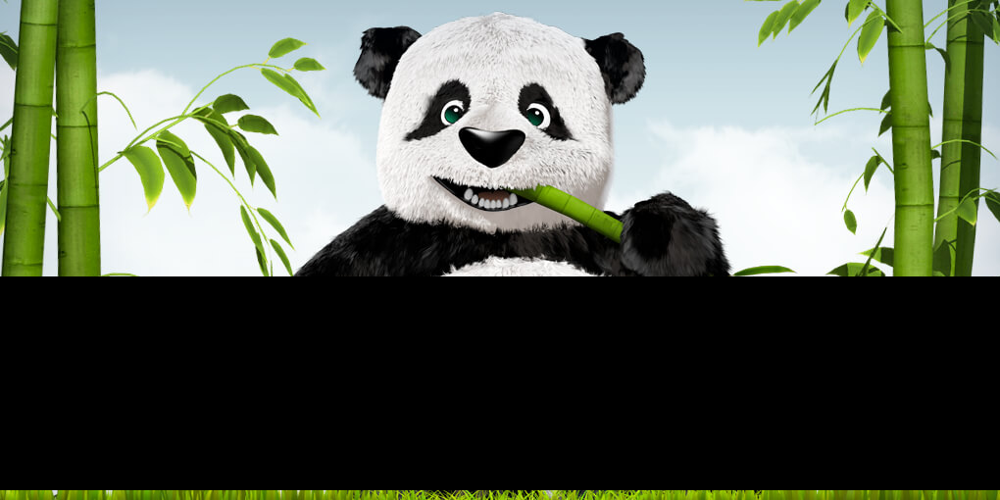

In [18]:
to_pil(out_pil.squeeze())

#### Affine Transformation

In [19]:
in_tensor = to_tensor(img)
in_pil = img
angle = 100.
translate_h = 0.1
translate_v = 0.2
params = rg.random_affine_generator(
    1, in_tensor.size(1), in_tensor.size(2), [-angle, angle], [translate_h, translate_v], [0.5, 0.9], [10, 20])
print(params)
transl = params['translations'].numpy()[0].tolist()

out_tensor = F.apply_affine(tensor_pre_transform_wrapper(in_tensor.unsqueeze(dim=0)), params)
out_pil = tvF.affine(in_pil, angle=params['angle'].item(), translate=transl,
                     scale=params['scale'].item(), shear=[params['sx'].item(), params['sy'].item()])

{'translations': tensor([[-70.0559,  57.8609]]), 'center': tensor([[509.5000, 254.5000]]), 'scale': tensor([0.5538]), 'angle': tensor([-28.7381]), 'sx': tensor([18.0250]), 'sy': tensor([13.8106]), 'resample': tensor(1), 'align_corners': tensor(False)}


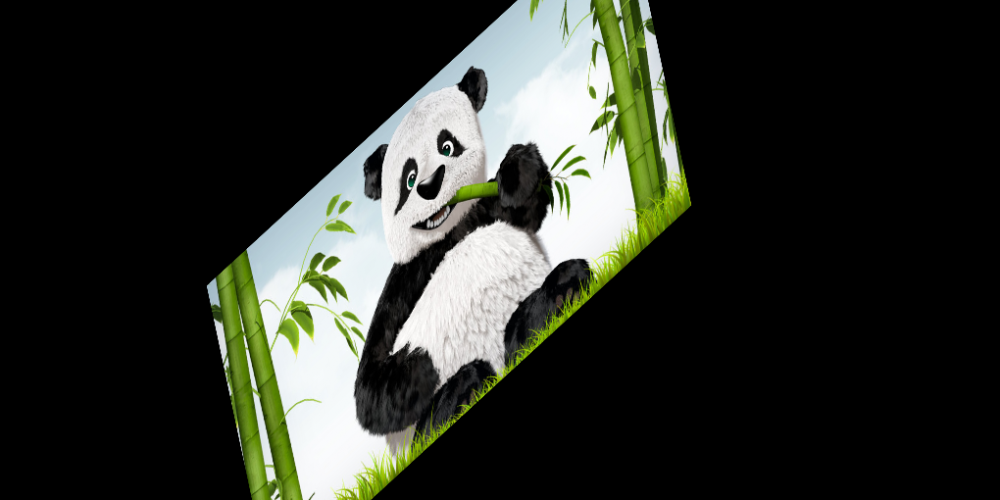

In [20]:
to_pil(out_tensor.squeeze())

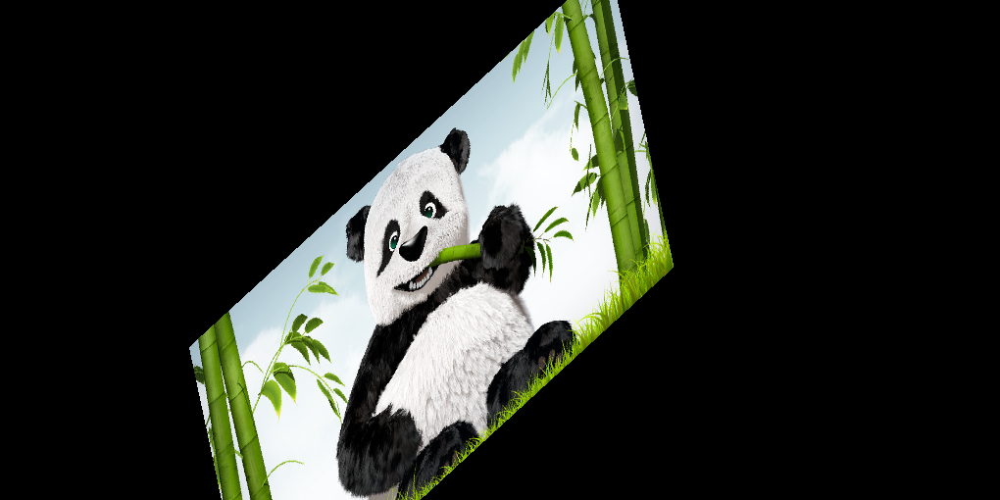

In [21]:
out_pil

#### RandomPerspective

In [22]:
in_tensor = to_tensor(img)
in_pil = img

params = rg.random_perspective_generator(1, in_tensor.size(1), in_tensor.size(2), p=1.0, distortion_scale=0.5)
out_tensor = F.apply_perspective(in_tensor, params)
out_pil = tvF.perspective(in_pil, startpoints=params['start_points'].squeeze().numpy().tolist(), endpoints=params['end_points'].squeeze().numpy().tolist())

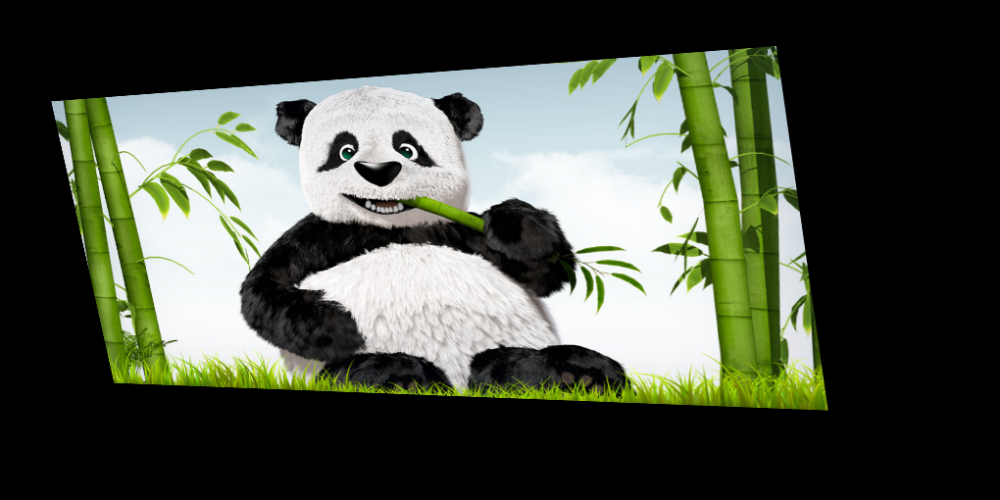

In [23]:
to_pil(out_tensor.squeeze())

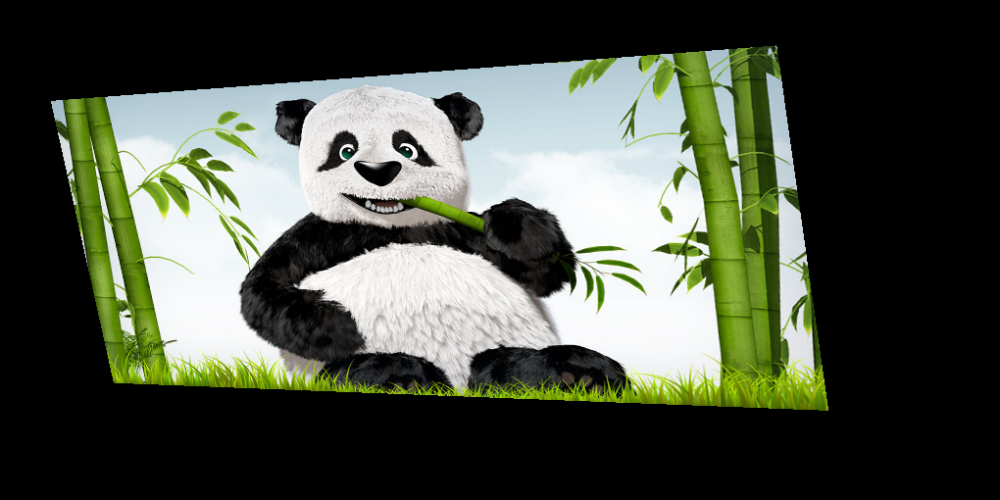

In [24]:
out_pil

#### Grayscale

In [25]:
in_tensor = to_tensor(img)
in_pil = img
out_tensor = F.rgb_to_grayscale(tensor_pre_transform_wrapper(in_tensor))
out_pil = tvF.to_grayscale(in_pil)

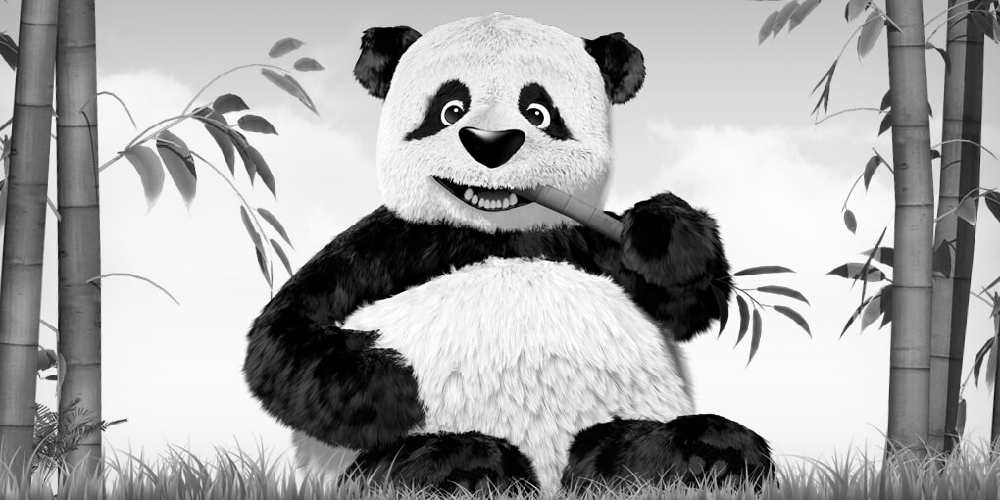

In [26]:
out_pil

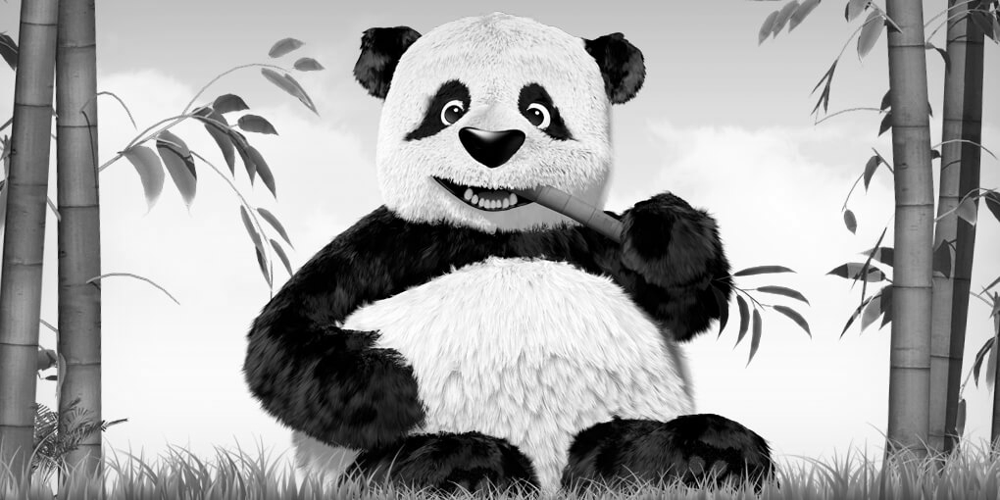

In [27]:
to_pil(out_tensor)

#### Adjust Contrast
Kornia follows OpenCV approach for contrast adjustment.

In [28]:
in_tensor = to_tensor(img)
in_pil = img
factor = 1.5
out_tensor = F.apply_adjust_contrast(tensor_pre_transform_wrapper(in_tensor), {'contrast_factor': torch.tensor(factor)})
out_pil = tvF.adjust_contrast(in_pil, factor)

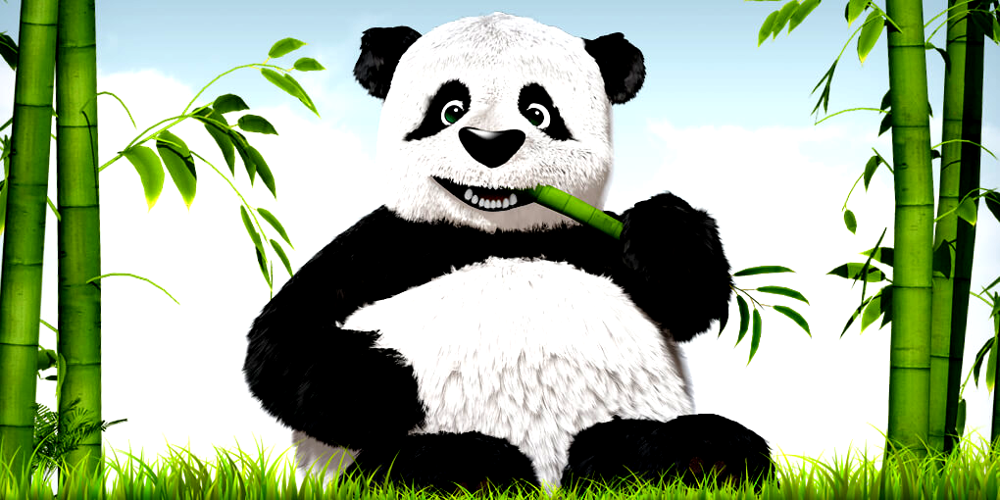

In [29]:
out_pil

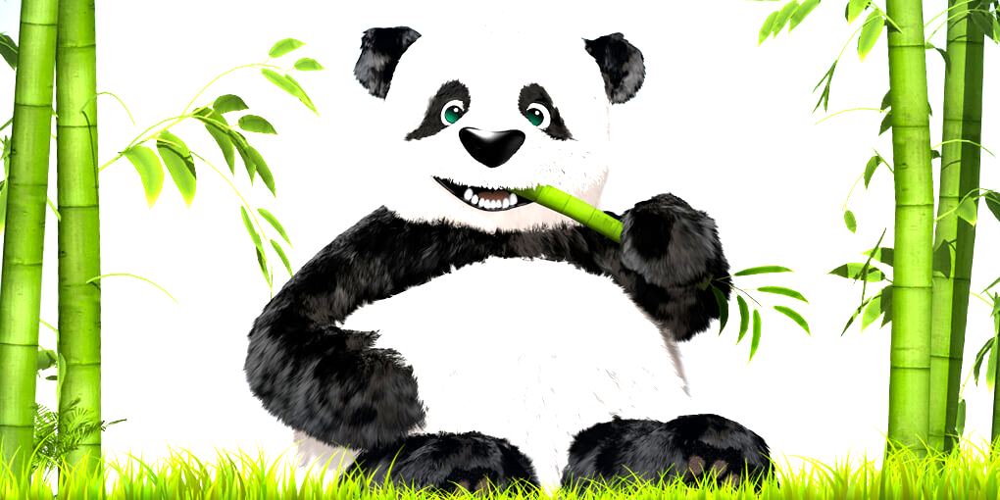

In [30]:
to_pil(out_tensor.squeeze())

#### Adjust Brightness
Kornia follows OpenCV approach for brightness adjustment.

In [31]:
in_tensor = to_tensor(img)
in_pil = img
factor = 1.5
out_tensor = F.apply_adjust_brightness(tensor_pre_transform_wrapper(in_tensor), {"brightness_factor": torch.tensor(factor)})
out_pil = tvF.adjust_brightness(in_pil, factor)

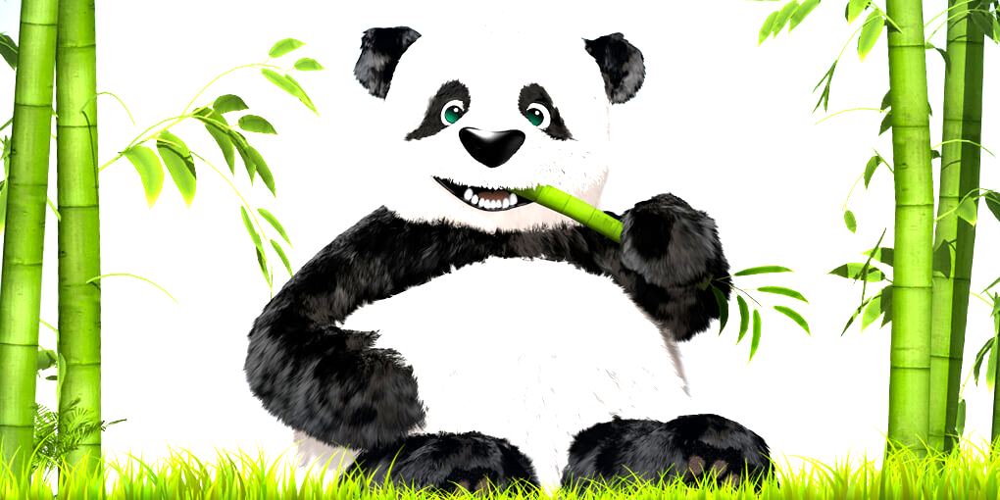

In [32]:
out_pil

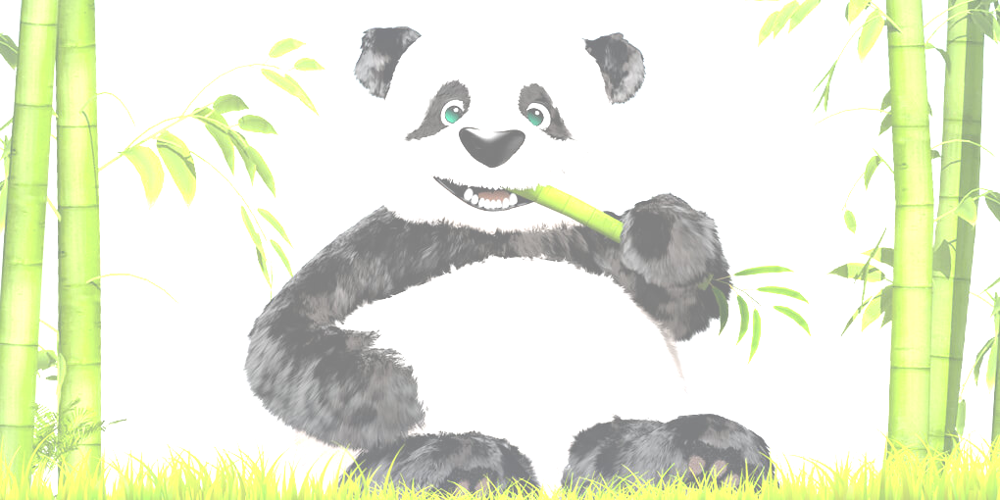

In [33]:
to_pil(out_tensor.squeeze())

#### Adjust Hue

In [34]:
in_tensor = to_tensor(img)
in_pil = img
factor = 0.2
out_tensor = F.apply_adjust_hue(tensor_pre_transform_wrapper(in_tensor), {"hue_factor": torch.tensor(factor)})
out_pil = tvF.adjust_hue(in_pil, factor)

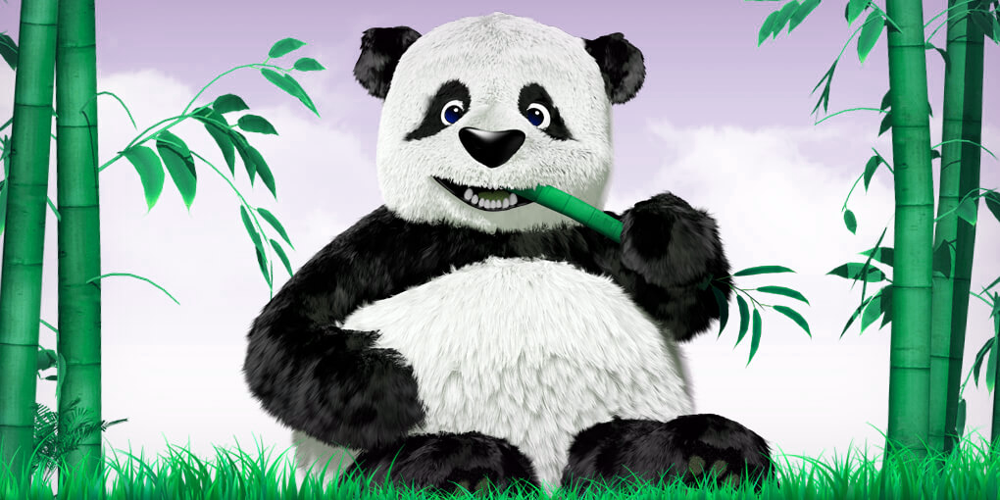

In [35]:
out_pil

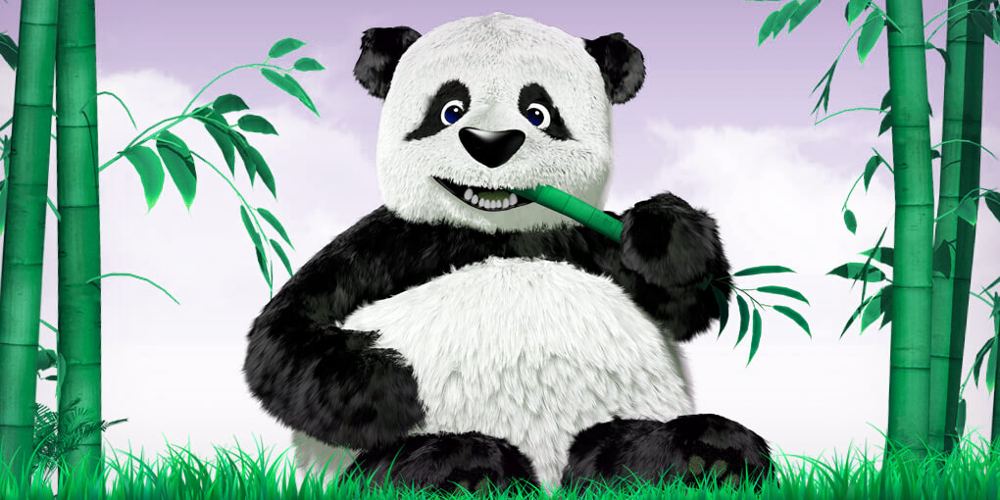

In [36]:
to_pil(out_tensor.squeeze())

#### Adjust Gamma

In [37]:
in_tensor = to_tensor(img)
in_pil = img
factor = 0.5
out_tensor = F.apply_adjust_gamma(tensor_pre_transform_wrapper(in_tensor), {"gamma_factor": torch.tensor(factor)})
out_pil = tvF.adjust_gamma(in_pil, factor)

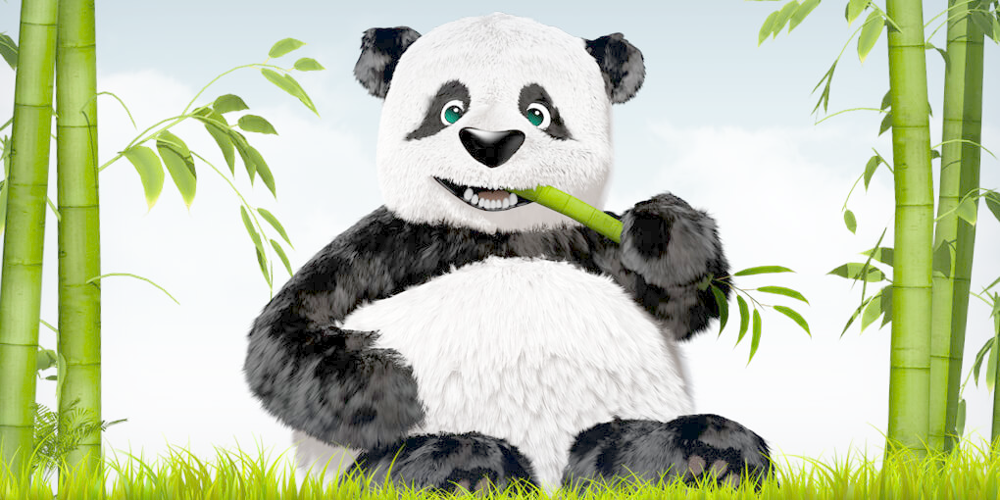

In [38]:
out_pil

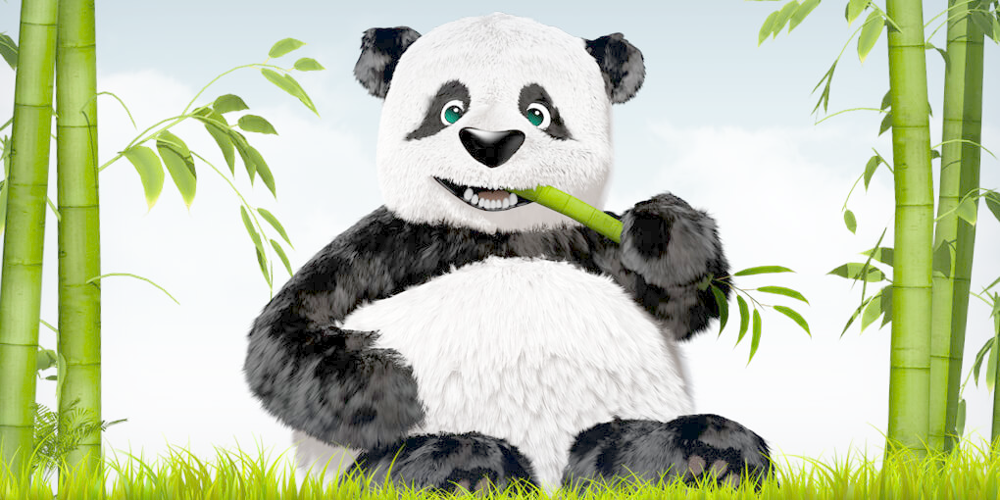

In [39]:
to_pil(out_tensor.squeeze())

#### Adjust Saturation

In [40]:
in_tensor = to_tensor(img)
in_pil = img
factor = 0.5
out_tensor = F.apply_adjust_saturation(tensor_pre_transform_wrapper(in_tensor), {"saturation_factor": torch.tensor(factor)})
out_pil = tvF.adjust_saturation(in_pil, factor)

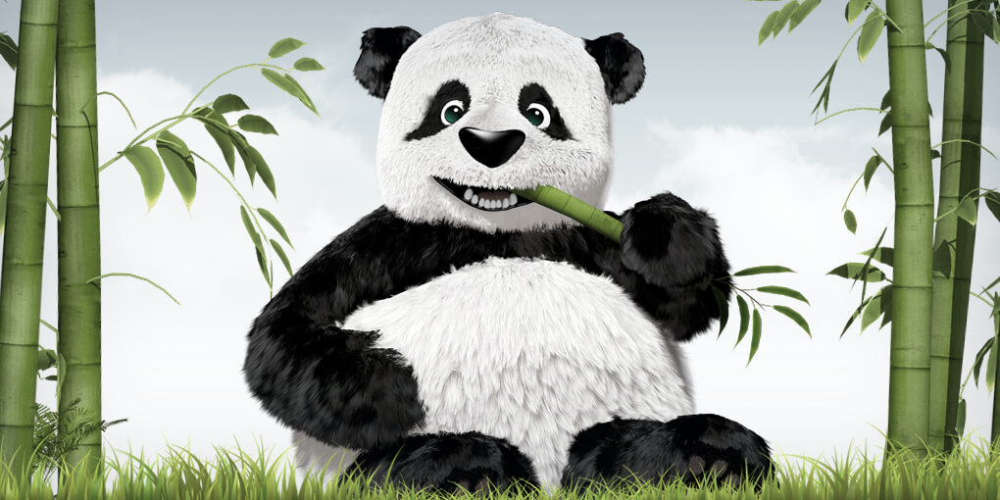

In [41]:
out_pil

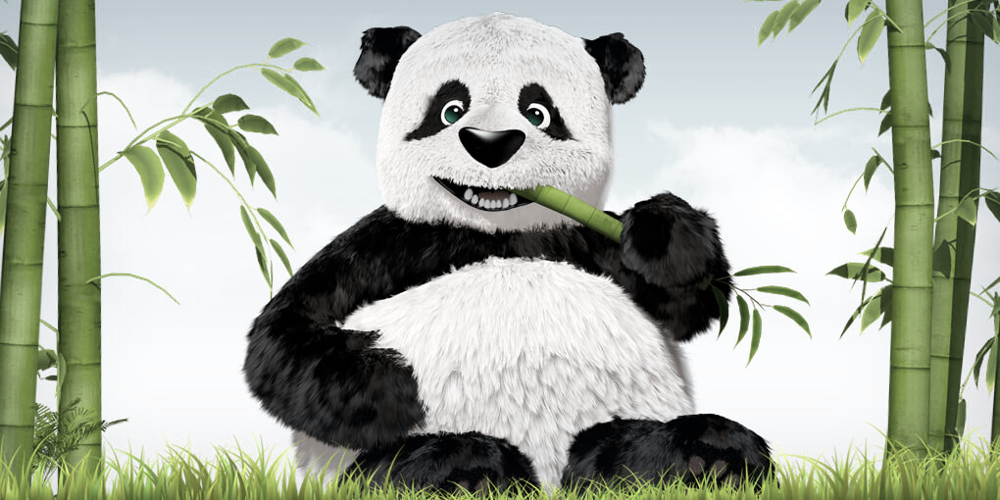

In [42]:
to_pil(out_tensor.squeeze())

# Advanced Augmentations

Please note that some transformations are based on uint8 format, which means it may not be differentiable.

## MotionBlur

{'ksize_factor': tensor([11]), 'angle_factor': tensor([19.1806]), 'direction_factor': tensor([-0.3481]), 'border_type': tensor(0)}


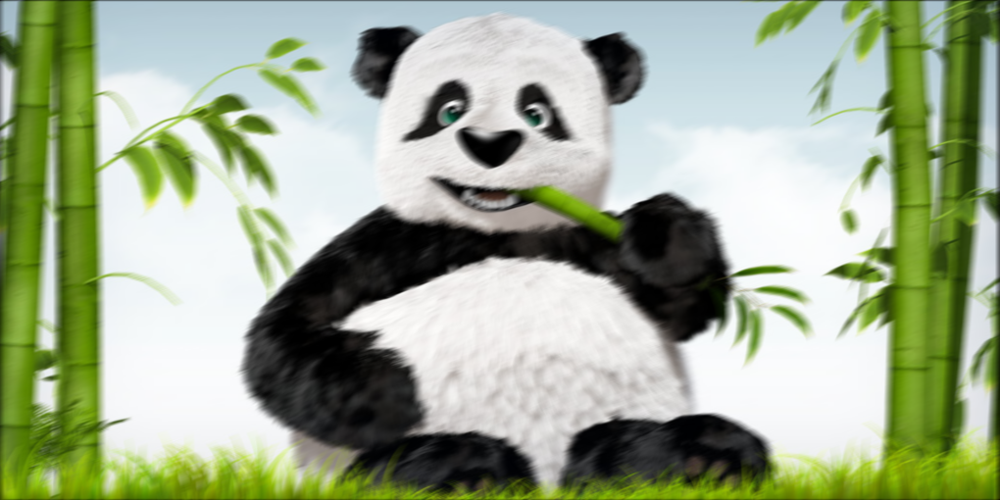

In [57]:
in_tensor = to_tensor(img)
in_pil = img
mb = K.RandomMotionBlur(11, 30., 0.4)
out_tensor = mb(tensor_pre_transform_wrapper(in_tensor))
print(mb._params)
to_pil(out_tensor.squeeze())

## Solarize

{'thresholds_factor': tensor([0.5761]), 'additions_factor': tensor([0.0962])}


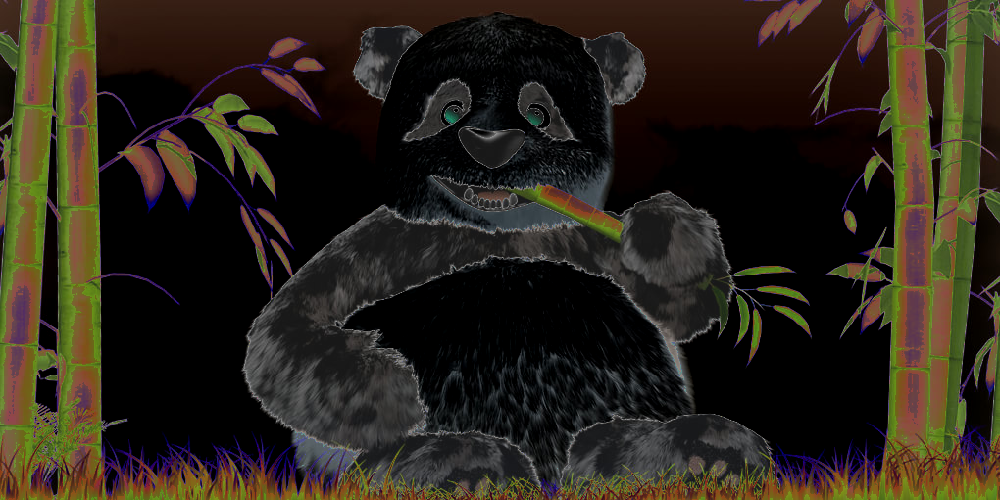

In [43]:
in_tensor = to_tensor(img)
in_pil = img
sol = K.RandomSolarize()
out_tensor = sol(tensor_pre_transform_wrapper(in_tensor))
print(sol._params)
to_pil(out_tensor.squeeze())

## Equalize

{'batch_prob': tensor([True])}


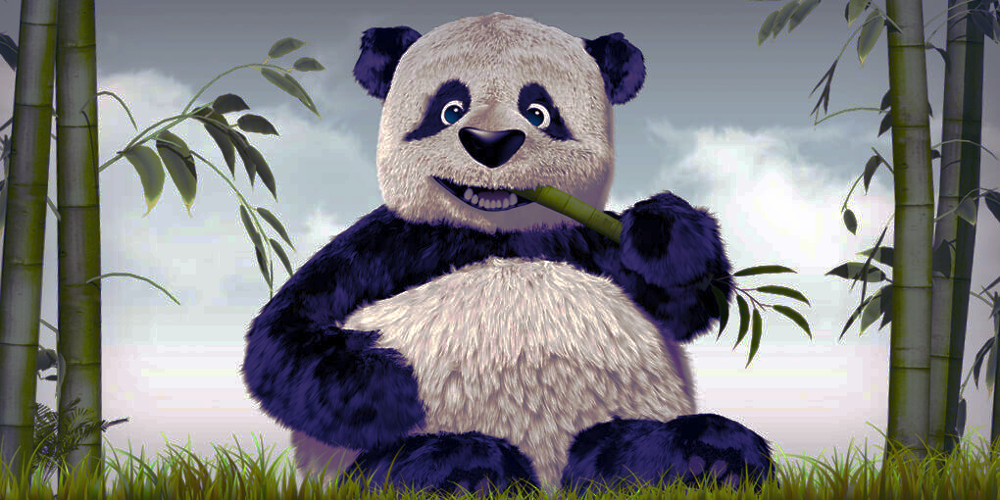

In [44]:
in_tensor = to_tensor(img)
in_pil = img
eql = K.RandomEqualize(1.)
out_tensor = eql(tensor_pre_transform_wrapper(in_tensor))
print(eql._params)
to_pil(out_tensor.squeeze())

## Posterize

{'bits_factor': tensor([3], dtype=torch.int32)}


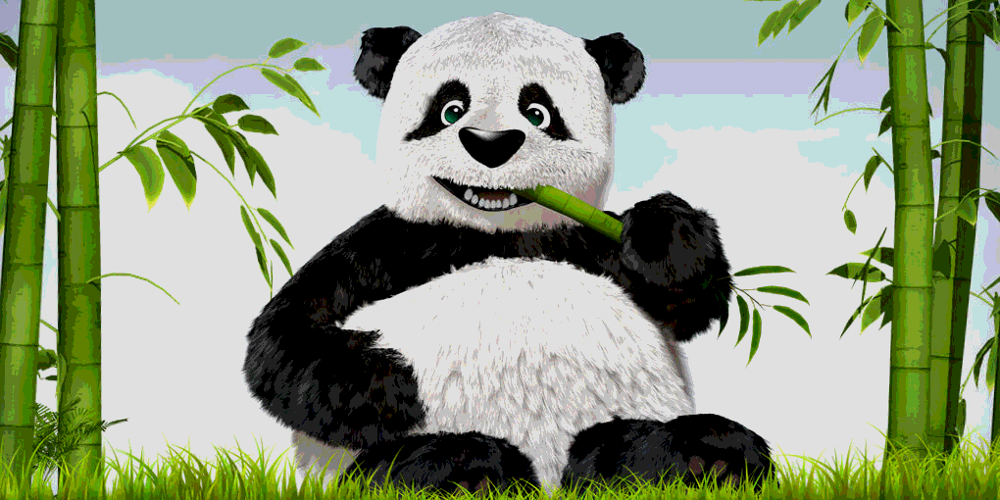

In [45]:
in_tensor = to_tensor(img)
in_pil = img
pos = K.RandomPosterize((2, 4))
out_tensor = pos(tensor_pre_transform_wrapper(in_tensor))
print(pos._params)
to_pil(out_tensor.squeeze())

## Sharpness

{'sharpness_factor': tensor([0.8898])}


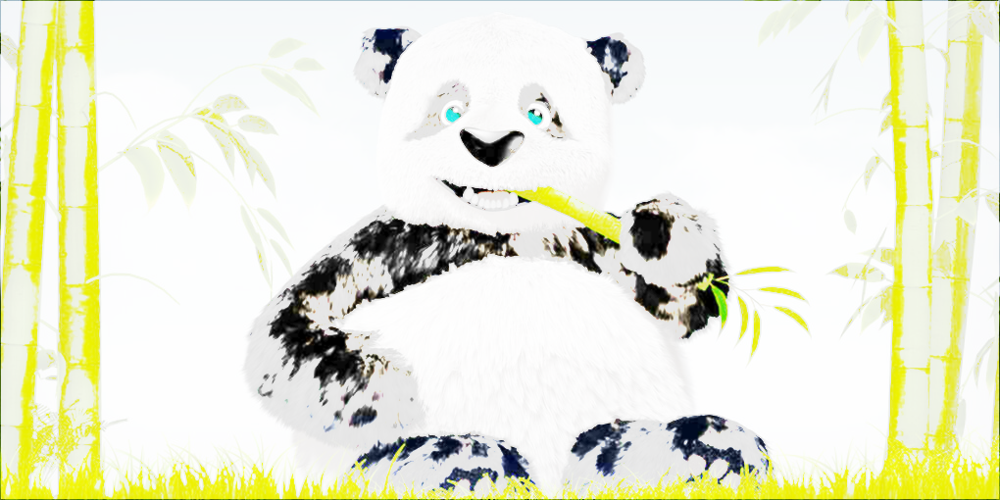

In [46]:
in_tensor = to_tensor(img)
in_pil = img
shp = K.RandomSharpness(1.)
out_tensor = shp(tensor_pre_transform_wrapper(in_tensor))
print(shp._params)
to_pil(out_tensor.squeeze())

# Batch-wise Transformations

Sometimes you may wish to apply the exact same transformations on all the elements in one batch. Here, we provided an ```same_on_batch``` keyword to all random generators for you to use. Instead of an element-wise parameter generating, it will generate exact same parameters across the whole batch. Still, if you are using input format other than BCHW, you may refactor your input first.

## An example of ColorJitter

In [47]:
params = rg.random_color_jitter_generator(2, 0.8, 0.8, 0.8, 0.3, same_on_batch=True)
out_tensor = F.apply_color_jitter(in_tensor.unsqueeze(dim=0).repeat((2, 1, 1, 1)), params)

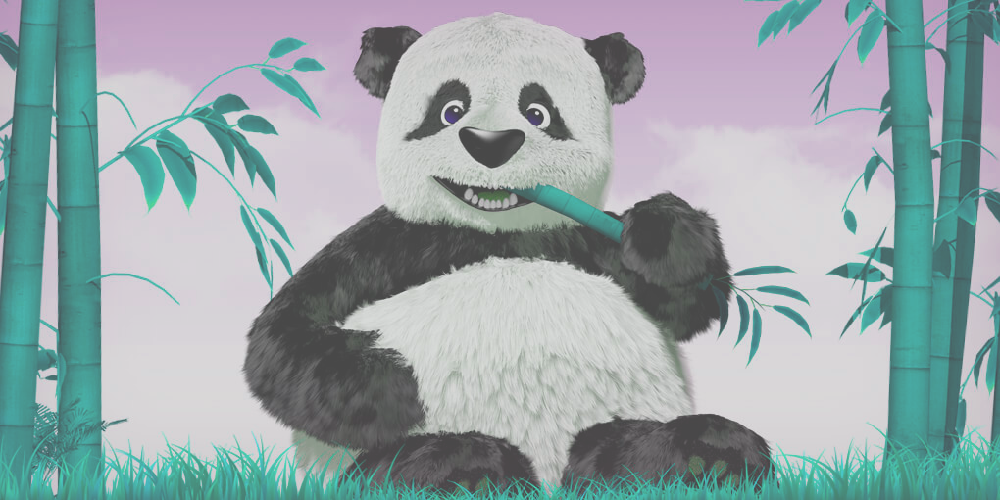

In [48]:
to_pil(out_tensor[0])

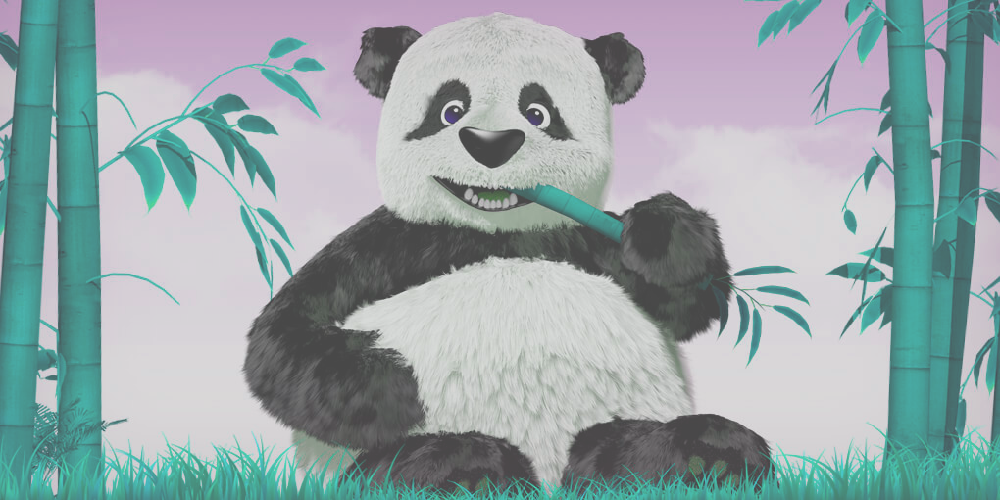

In [49]:
to_pil(out_tensor[1])

## An example of Affine Transformation

In [50]:
params = rg.random_affine_generator(2, in_tensor.shape[-2], in_tensor.shape[-1], [-45, 45], [0., 0.2], [0.8, 2.0], same_on_batch=True)
out_tensor = F.apply_affine(in_tensor.unsqueeze(dim=0).repeat((2, 1, 1, 1)), params)

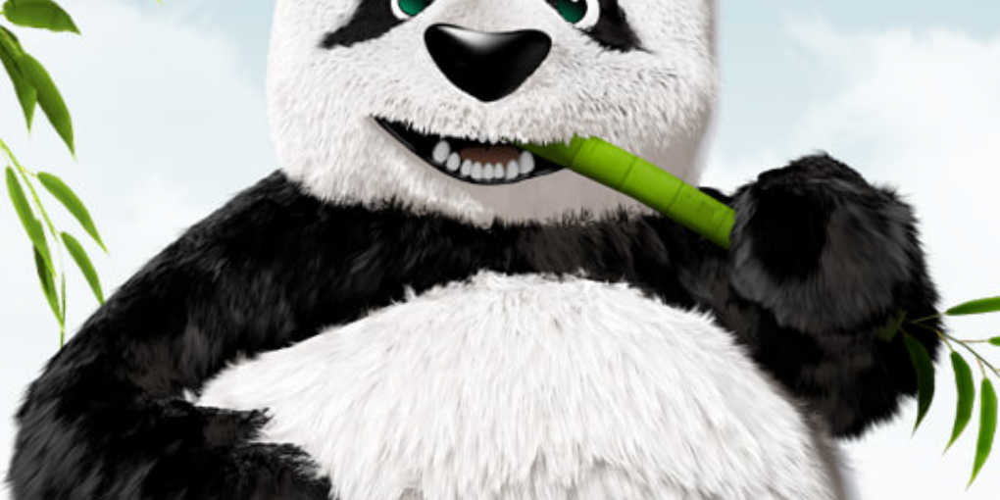

In [51]:
to_pil(out_tensor[0])

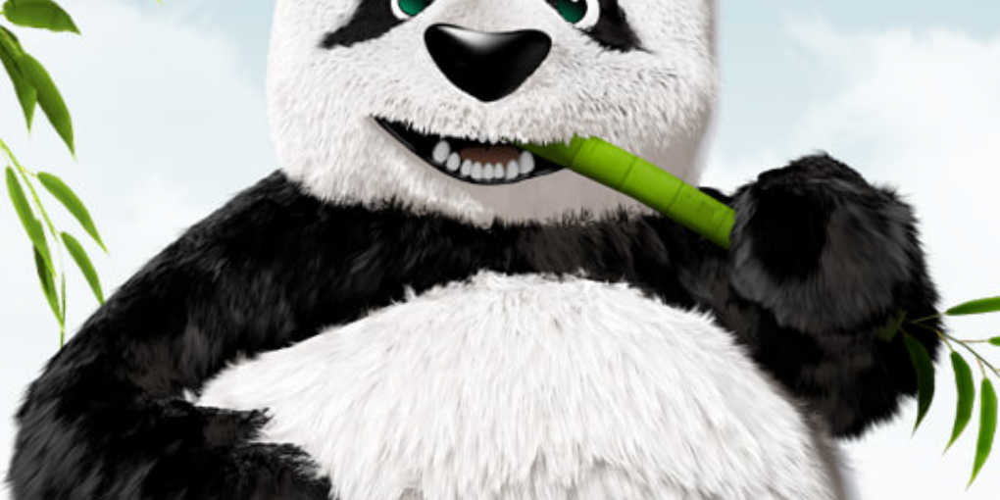

In [52]:
to_pil(out_tensor[1])